In [ ]:
import json

# Load hyperparameters or configurations from a JSON file
with open('config.json', 'r') as f:
    config = json.load(f)

# Example of accessing a parameter from the JSON file
learning_rate = config['learning_rate']
batch_size = config['batch_size']


In [4]:
import json
import numpy as np
import cv2
import os

# Paths
json_path = r'C:\Users\stsaa\Desktop\project\dataset\mergedannotations.json'
image_dir = r'C:\Users\stsaa\Desktop\project\dataset\images'
mask_output_dir = r'C:\Users\stsaa\Desktop\project\dataset\masks'
os.makedirs(mask_output_dir, exist_ok=True)

# Color mapping
color_map = {
    'BlueLane': [255, 0, 0],  # Blue
    'RedLane': [0, 0, 255]    # Red
}

# Load JSON data
with open(json_path, 'r') as f:
    data = json.load(f)

# Process each task
for task in data:
    raw_image_filename = task['data']['image'].split('/')[-1]  # e.g. "839f3d86-frame_0003.jpg"
    frame_image_filename = raw_image_filename.split('-')[-1]   # e.g. "frame_0003.jpg"

    image_path = os.path.join(image_dir, frame_image_filename)

    if not os.path.exists(image_path):
        print(f"Image not found: {image_path}. Skipping...")
        continue

    image = cv2.imread(image_path)
    if image is None:
        print(f"Failed to load image: {image_path}")
        continue

    mask = np.zeros(image.shape, dtype=np.uint8)

    # Process annotations
    for annotation in task['annotations']:
        for result in annotation.get('result', []):
            label = result['value']['polygonlabels'][0]
            points = np.array(result['value']['points'], dtype=np.float32)

            # Convert relative points to absolute pixel coordinates
            height, width = image.shape[:2]
            abs_points = np.round(points * [width / 100, height / 100]).astype(np.int32)
            cv2.fillPoly(mask, [abs_points], color_map.get(label, [0, 0, 0]))

    # Save mask
    mask_filename = os.path.join(mask_output_dir, frame_image_filename.replace('.jpg', '_mask.png'))
    cv2.imwrite(mask_filename, mask)
    print(f"Mask saved for {frame_image_filename}")


Mask saved for frame_0000.jpg
Mask saved for frame_0001.jpg
Mask saved for frame_0002.jpg
Mask saved for frame_0003.jpg
Mask saved for frame_0004.jpg
Mask saved for frame_0005.jpg
Mask saved for frame_0006.jpg
Mask saved for frame_0007.jpg
Mask saved for frame_0008.jpg
Mask saved for frame_0009.jpg
Mask saved for frame_0010.jpg
Mask saved for frame_0011.jpg
Mask saved for frame_0012.jpg
Mask saved for frame_0013.jpg
Mask saved for frame_0014.jpg
Mask saved for frame_0015.jpg
Mask saved for frame_0016.jpg
Mask saved for frame_0017.jpg
Mask saved for frame_0018.jpg
Mask saved for frame_0019.jpg
Mask saved for frame_0020.jpg
Mask saved for frame_0021.jpg
Mask saved for frame_0022.jpg
Mask saved for frame_0023.jpg
Mask saved for frame_0024.jpg
Mask saved for frame_0025.jpg
Mask saved for frame_0026.jpg
Mask saved for frame_0027.jpg
Mask saved for frame_0028.jpg
Mask saved for frame_0029.jpg
Mask saved for frame_0030.jpg
Mask saved for frame_0031.jpg
Mask saved for frame_0032.jpg
Mask saved

In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)


In [6]:
import os
import cv2
import numpy as np
from torch.utils.data import Dataset
import torchvision.transforms as transforms
import torchvision.transforms.functional as TF

class LaneDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.images = sorted(os.listdir(image_dir))
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.images[idx].replace('.jpg', '_mask.png'))

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        mask = cv2.imread(mask_path)
        mask = cv2.cvtColor(mask, cv2.COLOR_BGR2RGB)

        # Convert RGB mask to class mask (0 = bg, 1 = RedLane, 2 = BlueLane)
        class_mask = np.zeros(mask.shape[:2], dtype=np.uint8)
        class_mask[(mask == [255, 0, 0]).all(axis=2)] = 1  # RedLane
        class_mask[(mask == [0, 0, 255]).all(axis=2)] = 2  # BlueLane

        # Apply transformations
        if self.transform:
            image, class_mask = self.transform(image, class_mask)

        # Convert the image and mask to tensor format
        image = TF.to_tensor(image)
        class_mask = torch.from_numpy(class_mask).long()
        
        return image, class_mask


# Define the data augmentations and transformations
class ComposeTransform:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, mask):
        for t in self.transforms:
            image, mask = t(image, mask)
        return image, mask


class RandomRotation:
    def __init__(self, degrees):
        self.degrees = degrees

    def __call__(self, image, mask):
        angle = np.random.uniform(-self.degrees, self.degrees)
        image = TF.rotate(image, angle)
        mask = TF.rotate(mask, angle)
        return image, mask


class RandomHorizontalFlip:
    def __init__(self, prob=0.5):
        self.prob = prob

    def __call__(self, image, mask):
        if np.random.random() < self.prob:
            image = TF.hflip(image)
            mask = TF.hflip(mask)
        return image, mask


class ColorJitter:
    def __init__(self, brightness=0, contrast=0, saturation=0, hue=0):
        self.transform = transforms.ColorJitter(brightness, contrast, saturation, hue)

    def __call__(self, image, mask):
        image = self.transform(image)
        return image, mask


# Combine the transformations
transform = ComposeTransform([
    RandomRotation(30),  # Rotate images randomly by up to 30 degrees
    RandomHorizontalFlip(prob=0.5),  # Flip images horizontally with 50% probability
    ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),  # Adjust brightness, contrast, etc.
    transforms.Resize((128, 128))  # Resize the images to 128x128
])

# Create the dataset with transformations
dataset = LaneDataset(image_dir=r'C:\Users\stsaa\Desktop\project\dataset\images', mask_dir=r'C:\Users\stsaa\Desktop\project\dataset\masks', transform=transform)


In [8]:
import torch
import torch.nn as nn
import torch.optim as optim
import os

# Set CUDA_LAUNCH_BLOCKING for better error tracing
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

# Assuming TinyUNet and LaneDataset are defined earlier in your code

# Model, dataset, and loader initialization
model = TinyUNet(out_ch=3).cuda()  # Ensure the model is on the GPU
dataset = LaneDataset(r'C:\Users\stsaa\Desktop\project\dataset\images', r'C:\Users\stsaa\Desktop\project\dataset\masks')  # Adjust paths for local machine
loader = torch.utils.data.DataLoader(dataset, batch_size=4, shuffle=True)

criterion = nn.CrossEntropyLoss().cuda()  # CrossEntropyLoss on the GPU
optimizer = optim.Adam(model.parameters(), lr=1e-3)

# Training loop
num_epochs = 20  # Increased epochs for better results
for epoch in range(num_epochs):
    model.train()
    epoch_loss = 0
    for images, masks in loader:
        images, masks = images.cuda(), masks.cuda()  # Ensure data is on the same device

        outputs = model(images)

        # Ensure the mask values are within the expected range
        if torch.max(masks) >= outputs.size(1):  # Check if mask values exceed number of classes
            continue  # Skip this batch if there is an issue with the mask values

        loss = criterion(outputs, masks)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    print(f"Epoch {epoch+1}, Loss: {epoch_loss:.4f}")  # Only print epoch and loss

# Save the trained model
model_save_path = r"C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth"  # Adjust save path for your system
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")


Epoch 1, Loss: 43.1575
Epoch 2, Loss: 7.5731
Epoch 3, Loss: 4.5726
Epoch 4, Loss: 3.6542
Epoch 5, Loss: 3.2448
Epoch 6, Loss: 2.9291
Epoch 7, Loss: 2.7157
Epoch 8, Loss: 2.7476
Epoch 9, Loss: 2.4921
Epoch 10, Loss: 2.5017
Epoch 11, Loss: 2.4175
Epoch 12, Loss: 2.3704
Epoch 13, Loss: 2.3702
Epoch 14, Loss: 2.3561
Epoch 15, Loss: 2.3099
Epoch 16, Loss: 2.2654
Epoch 17, Loss: 2.4058
Epoch 18, Loss: 2.3774
Epoch 19, Loss: 2.1857
Epoch 20, Loss: 2.2217
Model saved to C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth


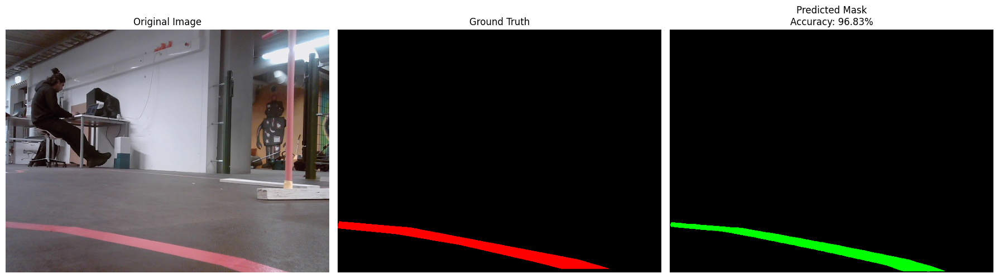

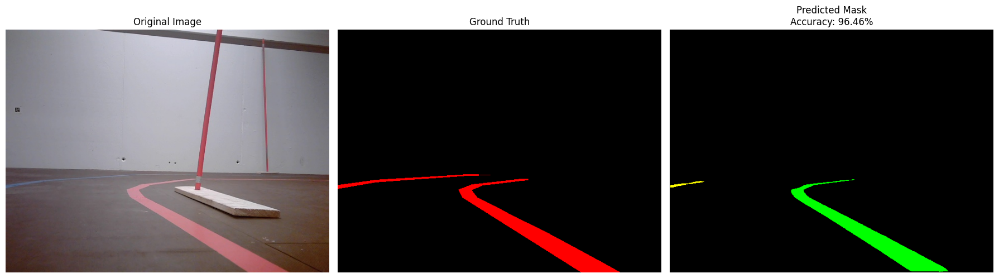

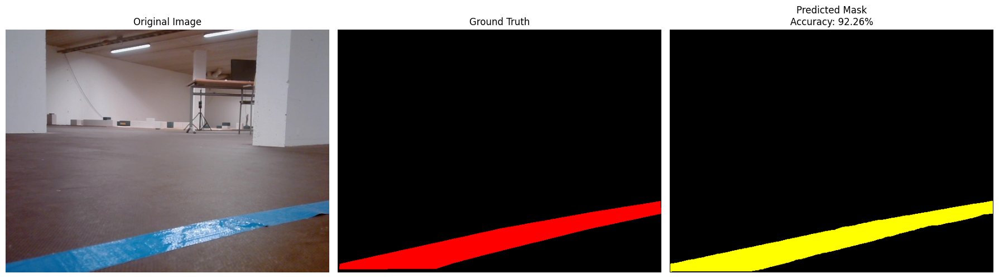

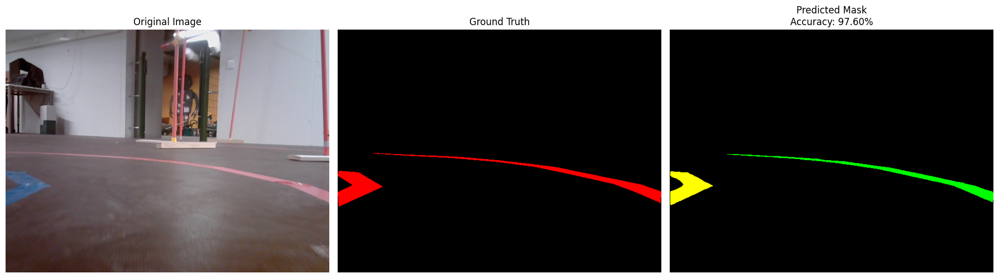

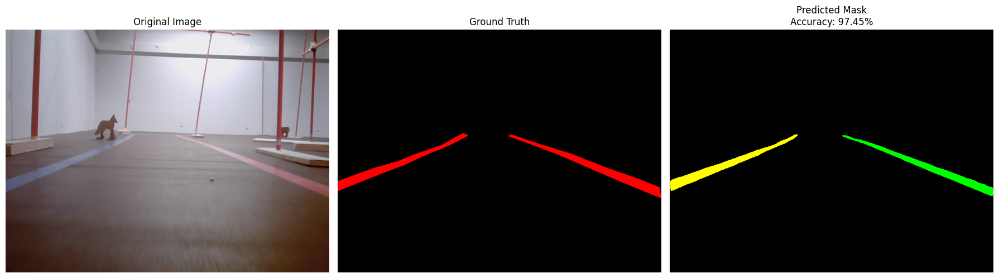

...

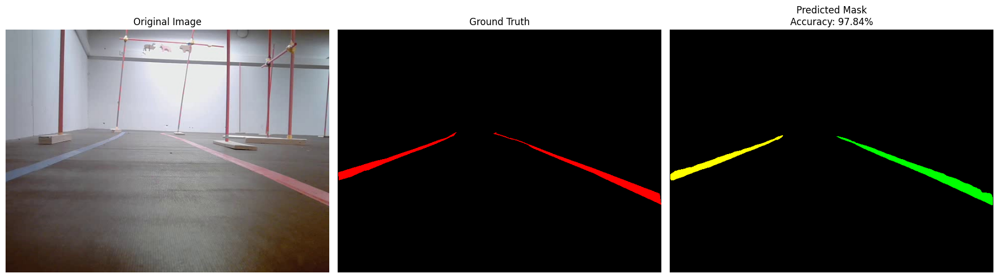

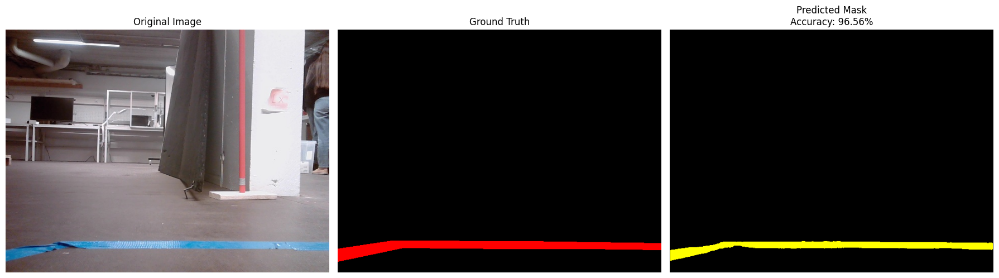

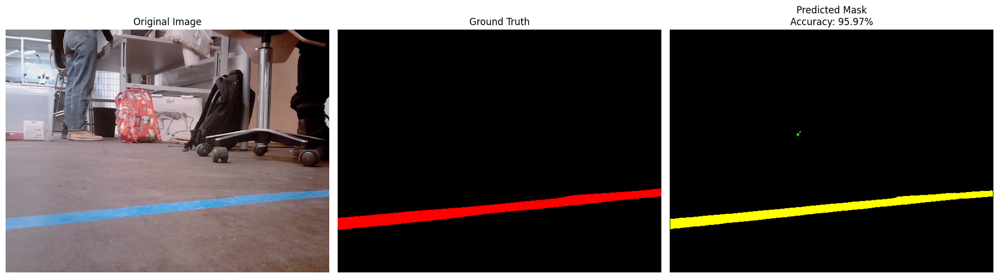

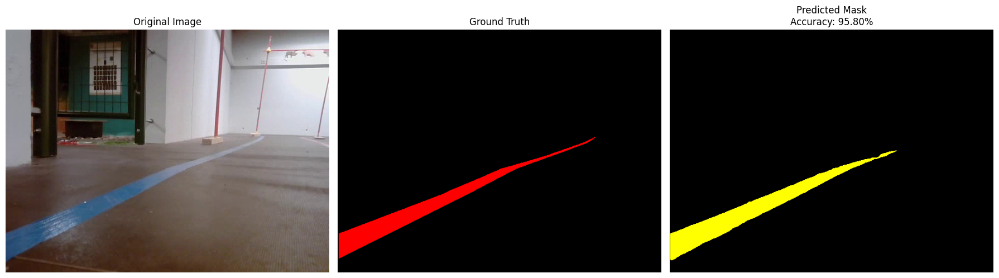

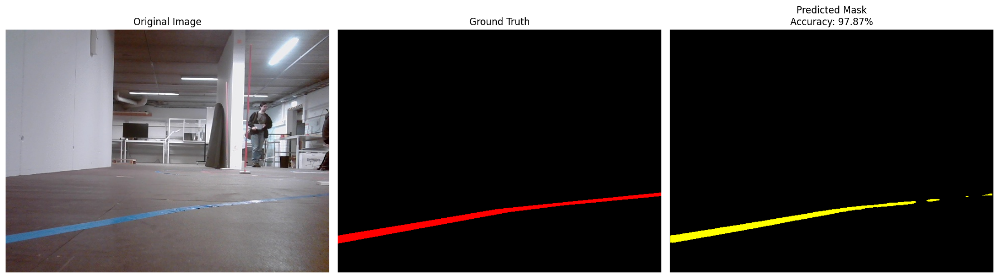


✅ Average Pixel Accuracy over 10 images: 96.64%


In [ ]:
import os
import torch
import random
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from PIL import Image
import torchvision.transforms as transforms
import numpy as np

# Set model to evaluation mode
model.eval()

# Directories
images_dir = r'C:\Users\stsaa\Desktop\project\dataset\images'
masks_dir = r'C:\Users\stsaa\Desktop\project\dataset\masks'

# Load image filenames
image_filenames = sorted([f for f in os.listdir(images_dir) if f.endswith('.jpg')])

# Randomly select 10 images
random.seed(42)
selected_images = random.sample(image_filenames, 30)

# Image transform
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

# Target transform
target_transform = transforms.Compose([
    transforms.Resize((480, 640), interpolation=Image.NEAREST),
])

# Color maps
# Ground truth: 0 = black, 1 = blue, 2 = red
cmap_gt = ListedColormap([
    (0.0, 0.0, 0.0),  # Background - black
    (0.0, 0.0, 1.0),  # Blue lane
    (1.0, 0.0, 0.0),  # Red lane
])

# Prediction: 0 = black, 1 = green, 2 = yellow
cmap_pred = ListedColormap([
    (0.0, 0.0, 0.0),  # Background - black
    (0.0, 1.0, 0.0),  # Green for predicted blue lane
    (1.0, 1.0, 0.0),  # Yellow for predicted red lane
])

# Accuracy storage
accuracies = []

# Evaluation loop
for img_file in selected_images:
    img_path = os.path.join(images_dir, img_file)
    mask_name = img_file.replace('.jpg', '_mask.png')
    mask_path = os.path.join(masks_dir, mask_name)

    # Load and preprocess
    image_pil = Image.open(img_path).convert('RGB')
    mask_pil = Image.open(mask_path).convert('L')

    image_tensor = transform(image_pil).unsqueeze(0).cuda()
    mask_resized = np.array(target_transform(mask_pil))

    # Predict
    with torch.no_grad():
        pred = model(image_tensor)[0].argmax(0).cpu().numpy()

    # Accuracy
    correct = (pred == mask_resized).sum()
    total = mask_resized.size
    accuracy = 100 * correct / total
    accuracies.append(accuracy)

    # Plotting
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image_pil)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask_resized, cmap=cmap_gt, vmin=0, vmax=2)
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred, cmap=cmap_pred, vmin=0, vmax=2)
    plt.title(f"Predicted Mask\nAccuracy: {accuracy:.2f}%", fontsize=12)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Average accuracy
average_accuracy = sum(accuracies) / len(accuracies)
print(f"\n✅ Average Pixel Accuracy over 10 images: {average_accuracy:.2f}%")



Image 1: frame_0114.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.39%


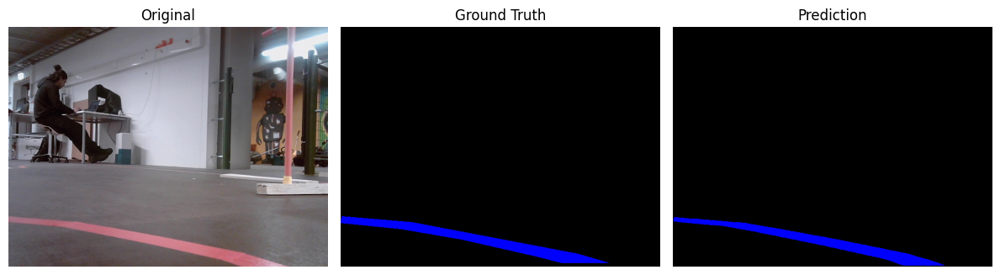


Image 2: frame_0025.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.37%


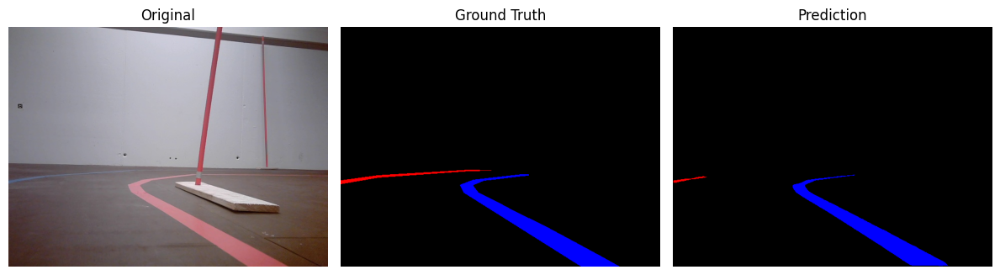


Image 3: frame_0281.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.44%


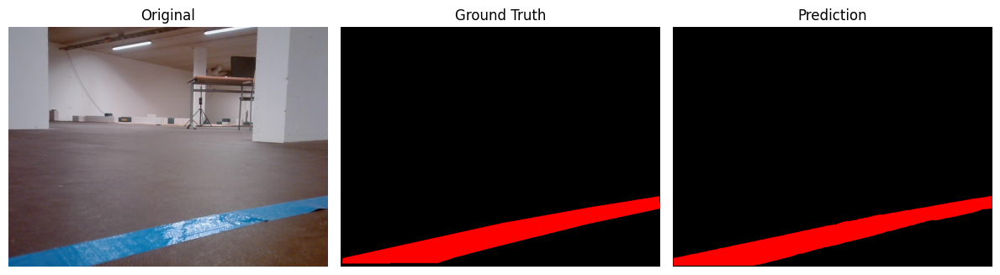


Image 4: frame_0250.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.66%


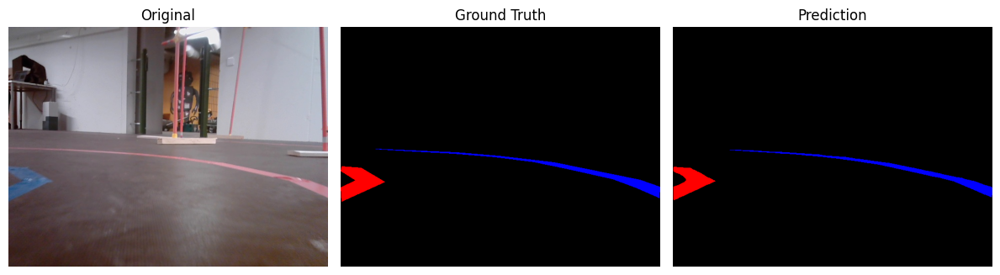


Image 5: frame_0228.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.60%


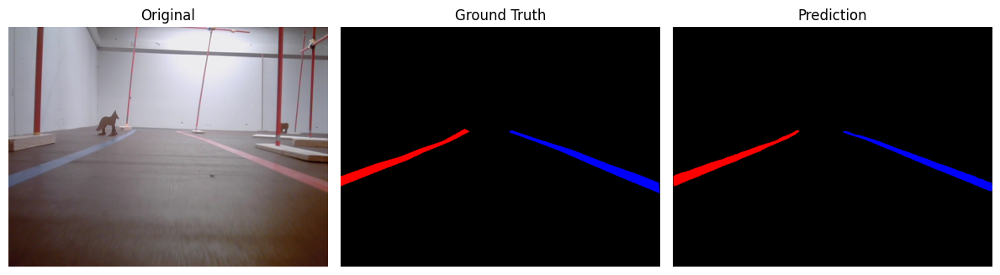


Image 6: frame_0142.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.27%


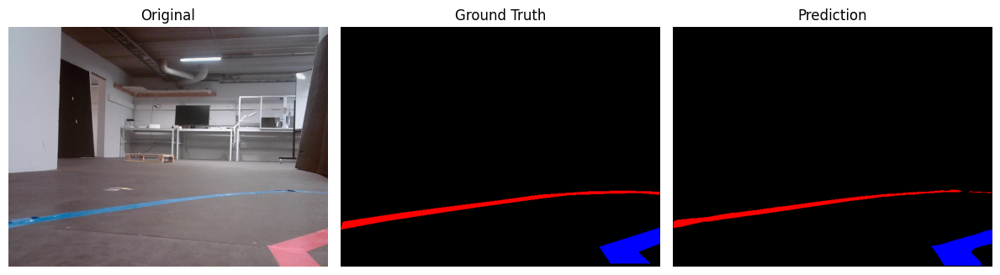


Image 7: frame_0104.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.60%


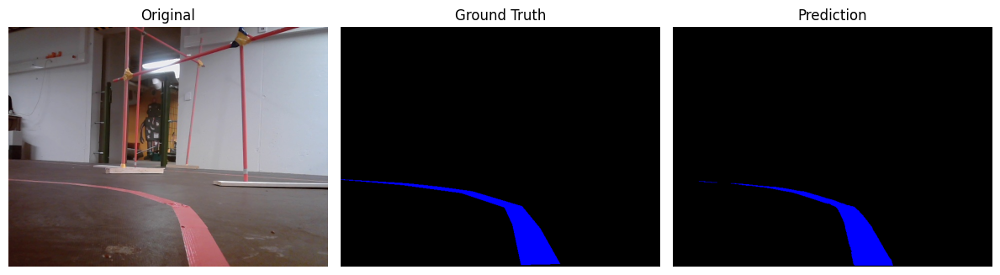


Image 8: frame_0558.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.38%


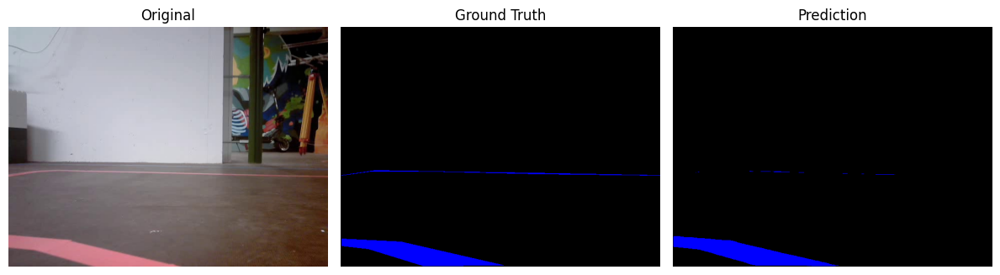


Image 9: frame_0089.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.48%


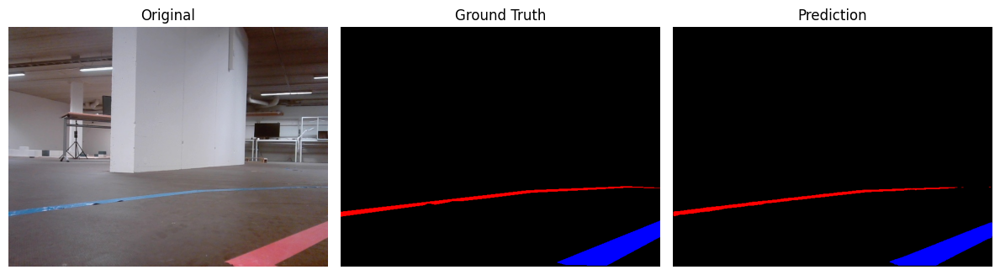


Image 10: frame_0432.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.20%


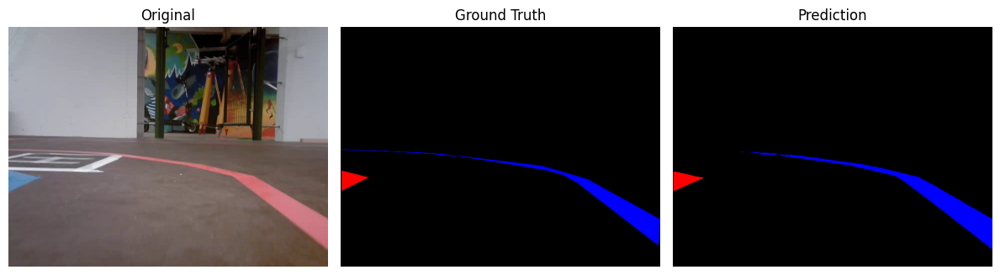


✅ Average Pixel Accuracy over 10 images: 99.44%


In [ ]:
import os
import torch
import random
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Model is already loaded and on GPU as `model`
model.eval()

# Paths
images_dir = r'C:\Users\stsaa\Desktop\project\dataset\images'
masks_dir = r'C:\Users\stsaa\Desktop\project\dataset\masks'

# Transforms
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])
target_transform = transforms.Compose([
    transforms.Resize((480, 640), interpolation=Image.NEAREST),
])

# Color map: background, blue, red
cmap = ListedColormap([
    (0.0, 0.0, 0.0),  # background (black)
    (0.0, 0.0, 1.0),  # blue lane (blue)
    (1.0, 0.0, 0.0),  # red lane (red)
])

# Remap grayscale values in masks to class indices
def remap_mask(mask):
    mapped = np.zeros_like(mask)
    mapped[mask == 29] = 2  # red lane
    mapped[mask == 76] = 1  # blue lane
    return mapped

# Load images
image_filenames = sorted([f for f in os.listdir(images_dir) if f.endswith('.jpg')])
random.seed(42)
selected_images = random.sample(image_filenames, 10)

accuracies = []

for idx, img_file in enumerate(selected_images):
    img_path = os.path.join(images_dir, img_file)
    mask_path = os.path.join(masks_dir, img_file.replace('.jpg', '_mask.png'))

    image_pil = Image.open(img_path).convert('RGB')
    mask_pil = Image.open(mask_path).convert('L')

    image_tensor = transform(image_pil).unsqueeze(0).cuda()
    mask_np = remap_mask(np.array(target_transform(mask_pil)))

    with torch.no_grad():
        pred = model(image_tensor)[0].argmax(0).cpu().numpy()

    # Accuracy
    correct = (pred == mask_np).sum()
    total = mask_np.size
    accuracy = 100 * correct / total
    accuracies.append(accuracy)

    # Class detection
    gt_classes = set(np.unique(mask_np)) - {0}
    has_blue = 1 in gt_classes
    has_red = 2 in gt_classes

    if has_blue and has_red:
        presence = "🟦 Blue Lane & 🟥 Red Lane"
    elif has_blue:
        presence = "🟦 Blue Lane only"
    elif has_red:
        presence = "🟥 Red Lane only"
    else:
        presence = "⚫ No Lanes Detected"

    # Print
    print(f"\nImage {idx+1}: {img_file}")
    print(f"✔️ {presence}")
    print(f"🎯 Pixel Accuracy: {accuracy:.2f}%")

    # Show
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(image_pil)
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask_np, cmap=cmap, vmin=0, vmax=2)
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred, cmap=cmap, vmin=0, vmax=2)
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Average accuracy
avg_accuracy = sum(accuracies) / len(accuracies)
print(f"\n✅ Average Pixel Accuracy over {len(selected_images)} images: {avg_accuracy:.2f}%")



Image 1: frame_0114.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.39%


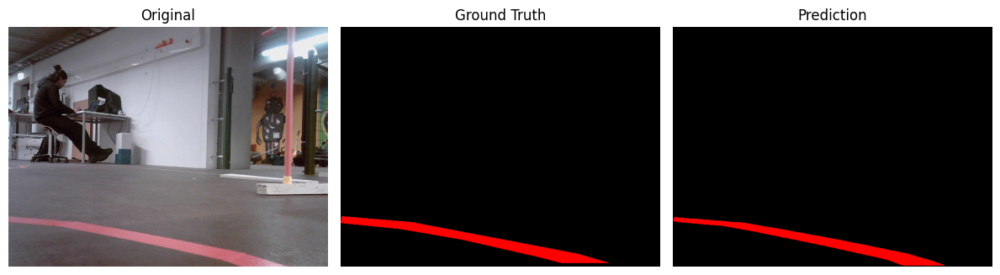


Image 2: frame_0025.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.37%


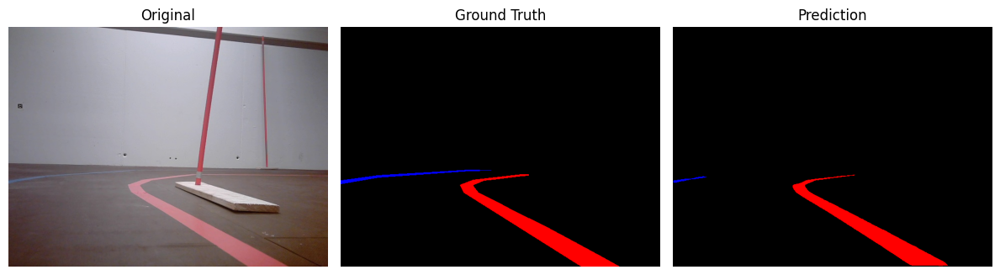


Image 3: frame_0281.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.44%


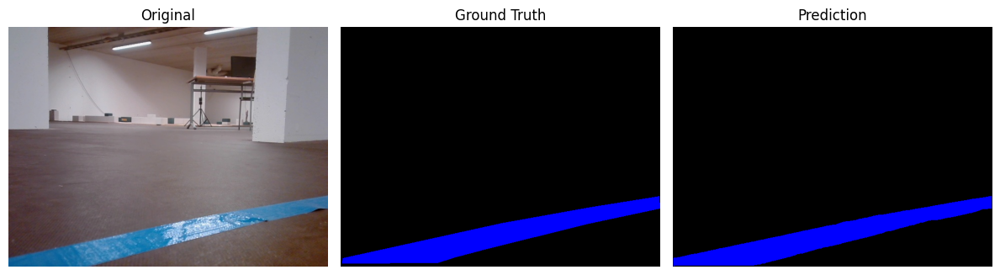


Image 4: frame_0250.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.66%


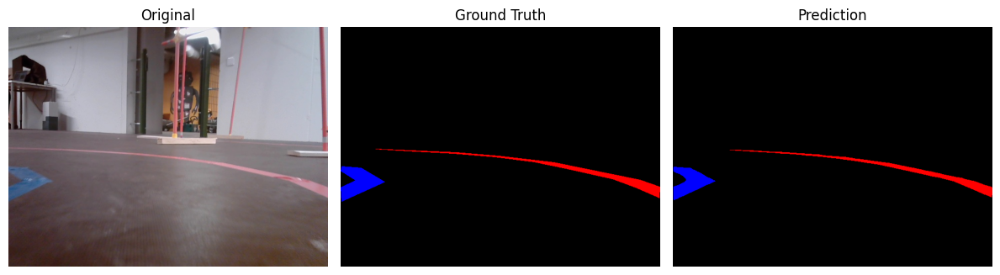


Image 5: frame_0228.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.60%


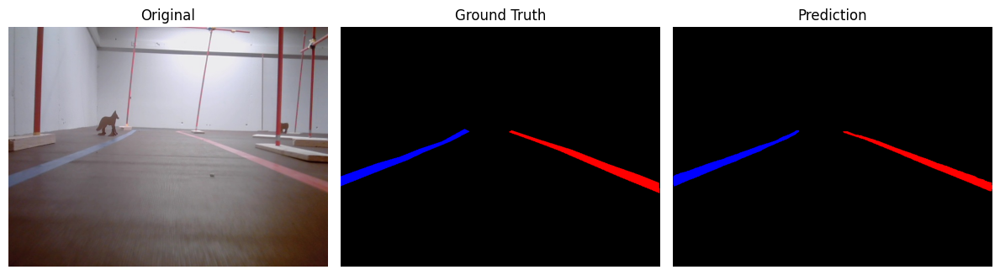


Image 6: frame_0142.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.27%


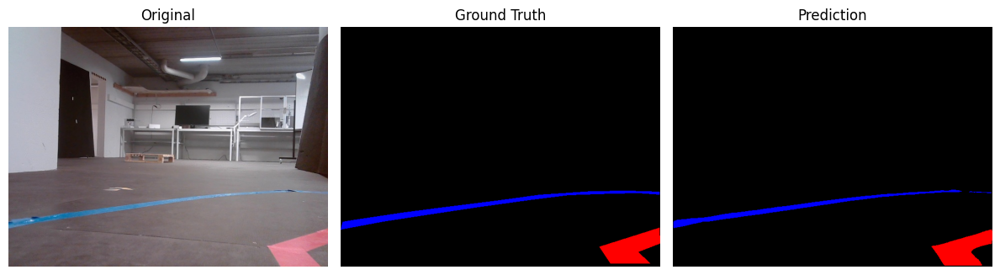


Image 7: frame_0104.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.60%


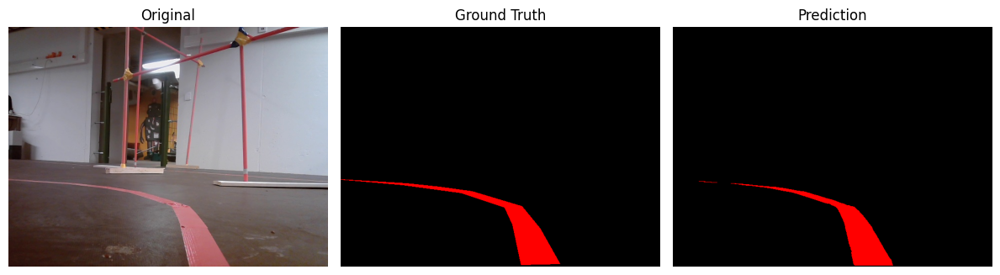


Image 8: frame_0558.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.38%


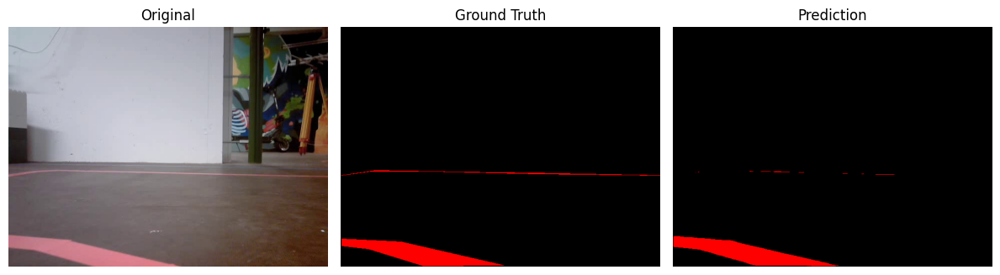


Image 9: frame_0089.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.48%


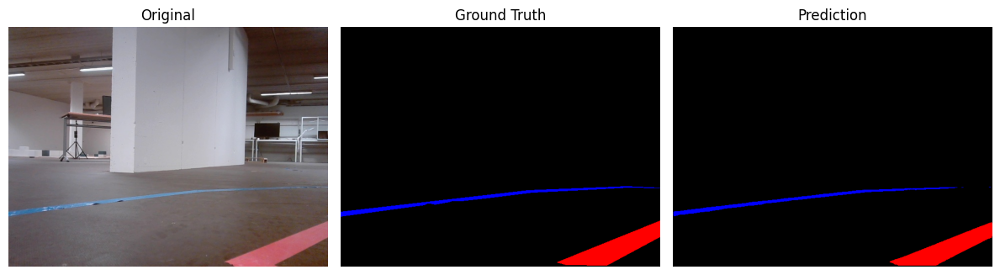


Image 10: frame_0432.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.20%


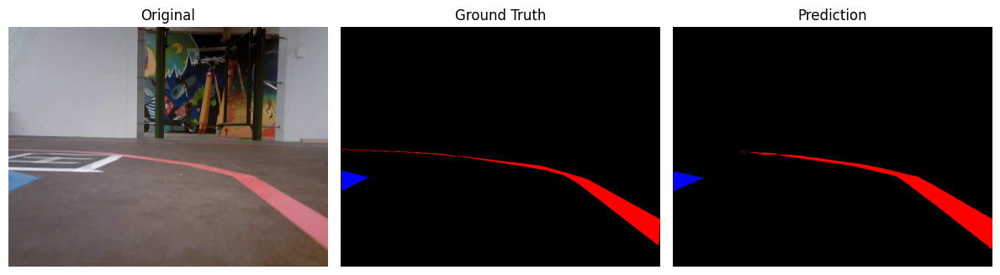


Image 11: frame_0032.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.68%


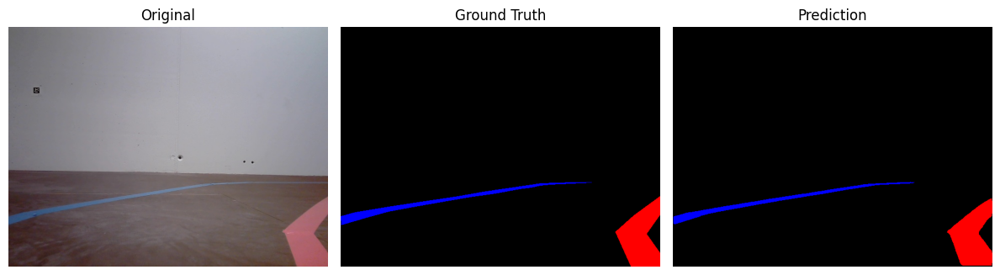


Image 12: frame_0030.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.65%


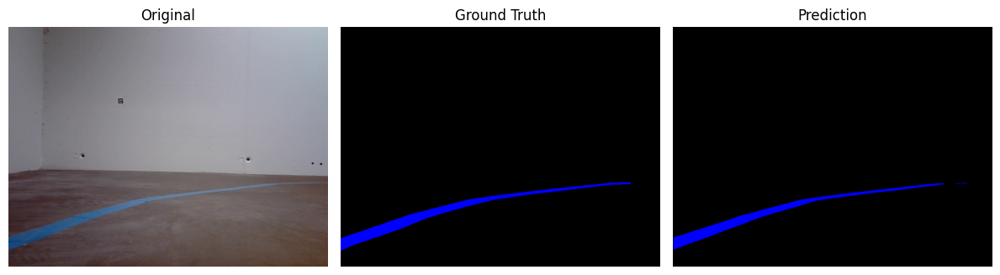


Image 13: frame_0095.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.59%


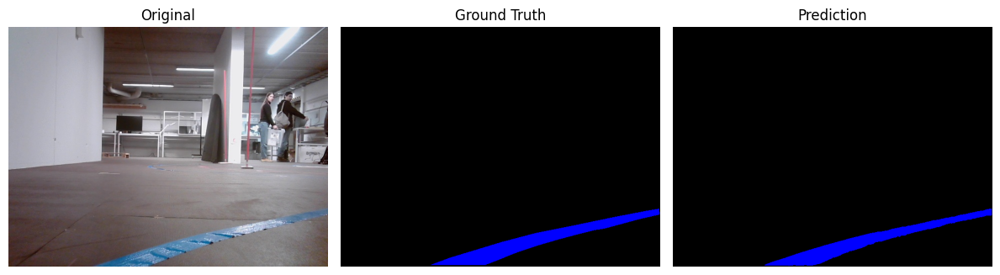


Image 14: frame_0223.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.32%


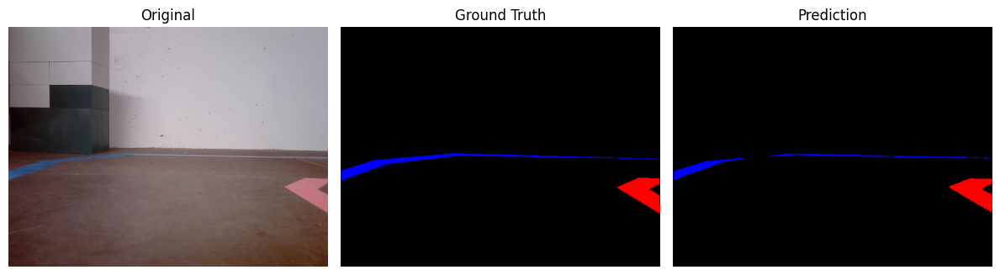


Image 15: frame_0238.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.56%


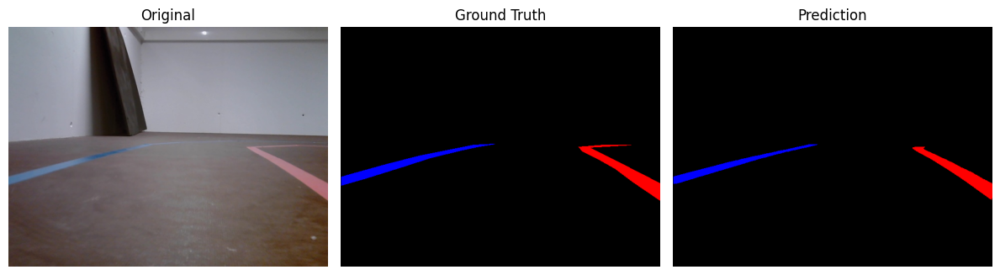


Image 16: frame_0517.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.88%


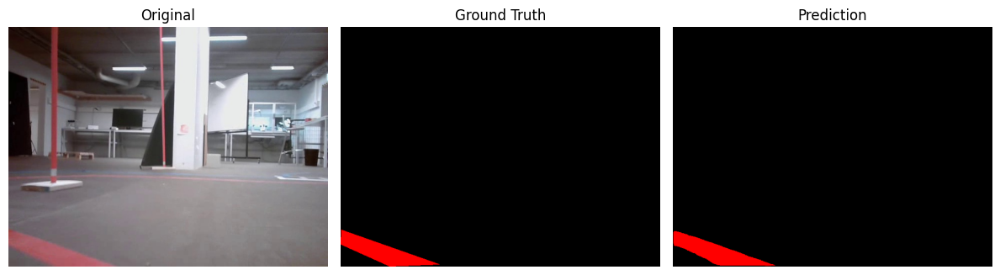


Image 17: frame_0027.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.37%


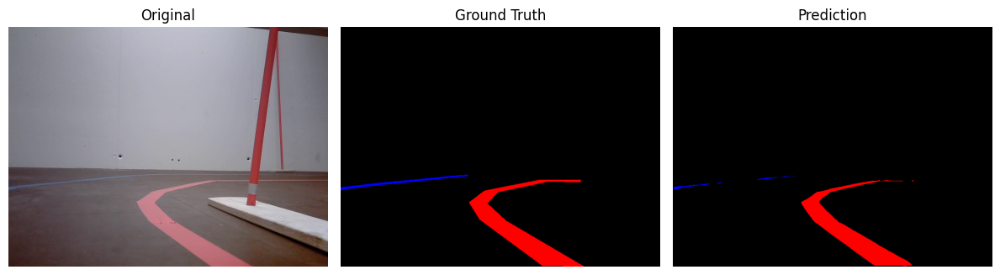


Image 18: frame_0574.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 98.87%


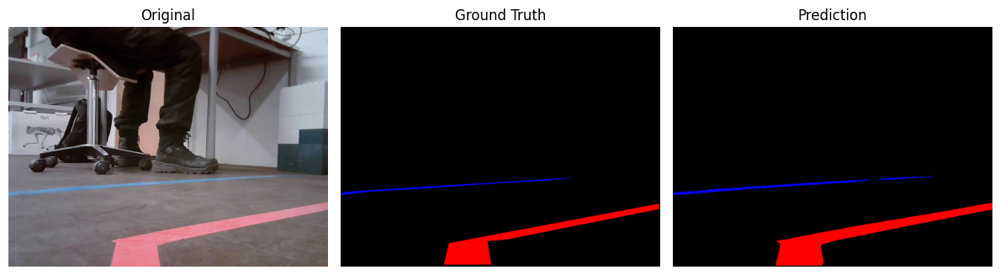


Image 19: frame_0203.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 98.85%


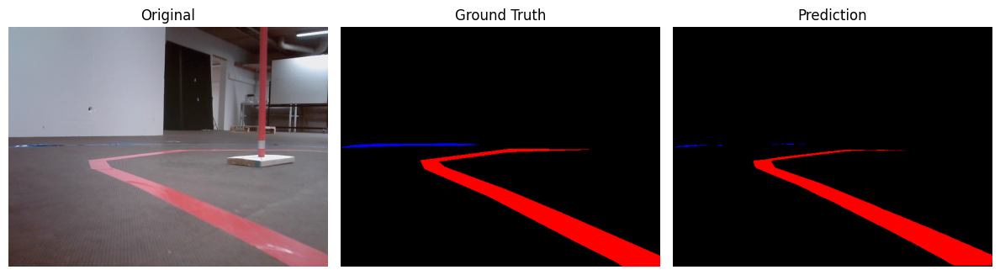


Image 20: frame_0429.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.16%


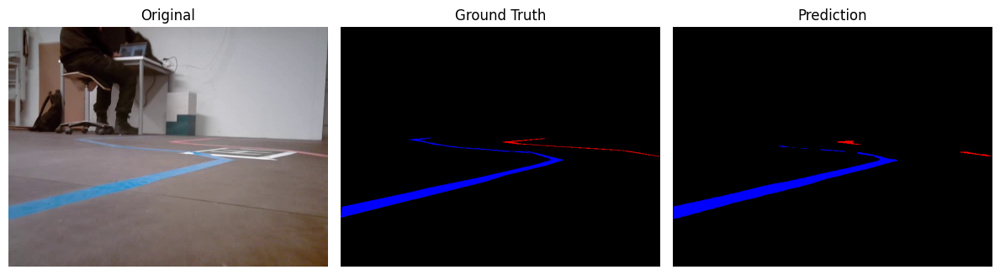


Image 21: frame_0225.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.45%


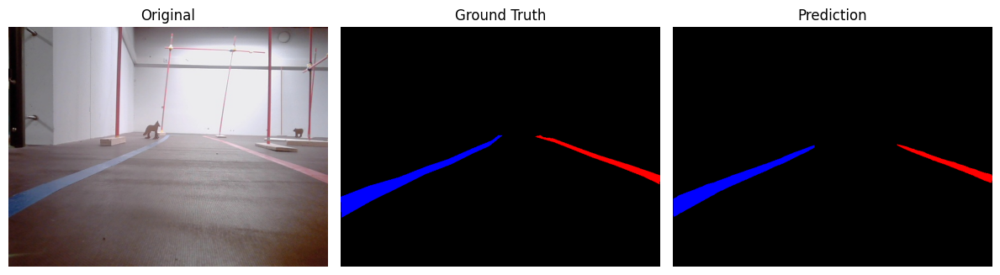


Image 22: frame_0459.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.64%


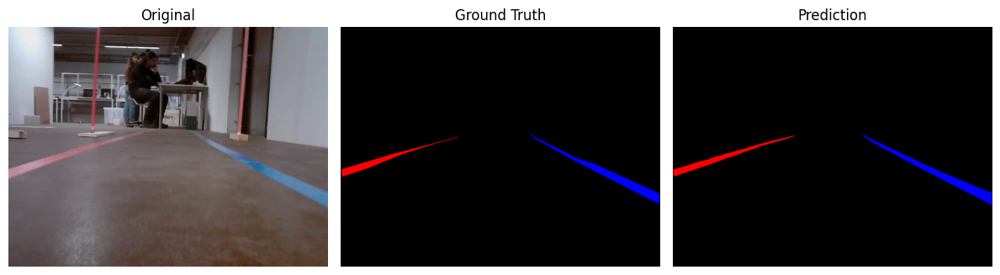


Image 23: frame_0284.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.64%


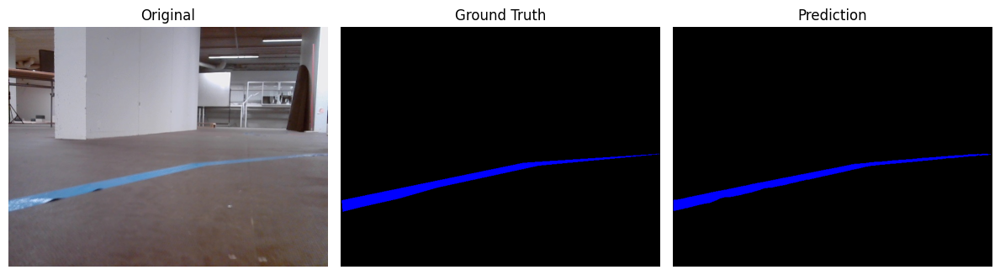


Image 24: frame_0006.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.61%


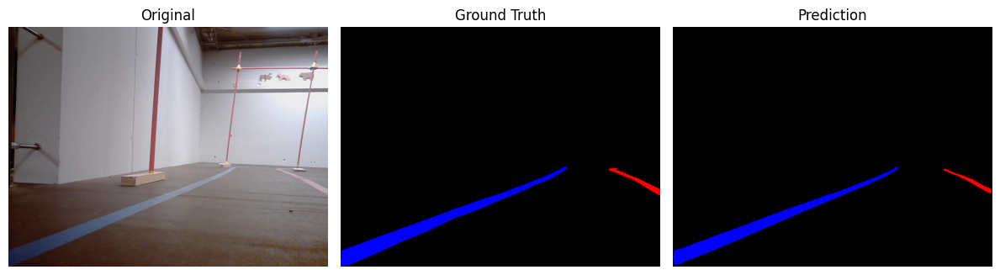


Image 25: frame_0163.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.12%


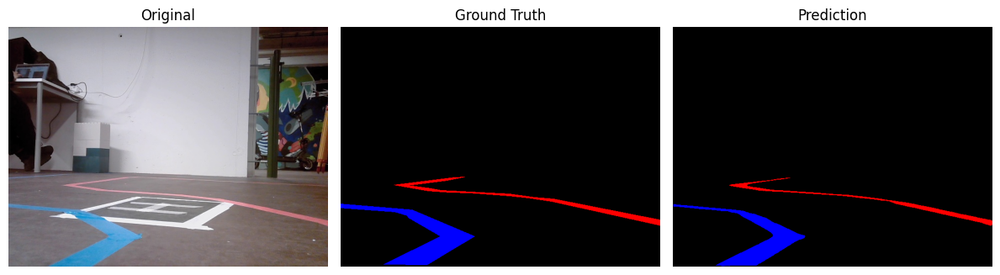


Image 26: frame_0348.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.46%


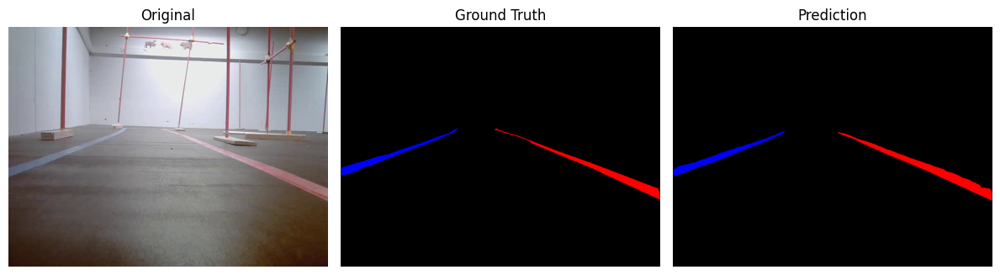


Image 27: frame_0159.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.29%


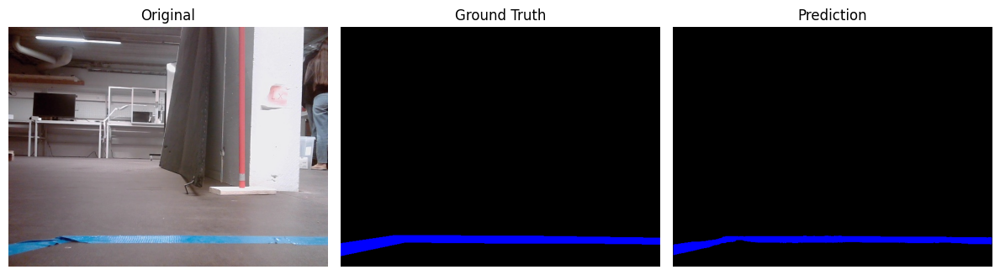


Image 28: frame_0220.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.34%


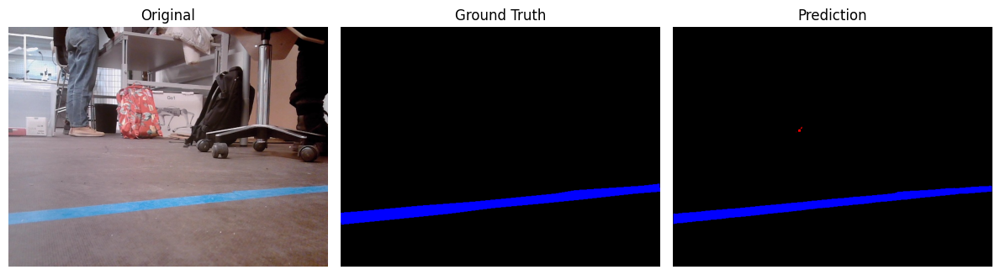


Image 29: frame_0344.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.40%


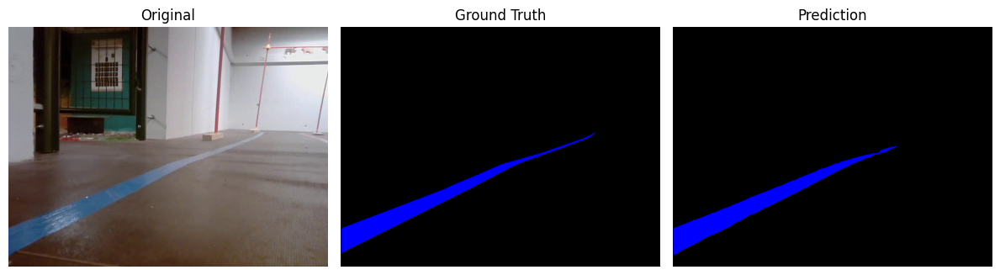


Image 30: frame_0094.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.50%


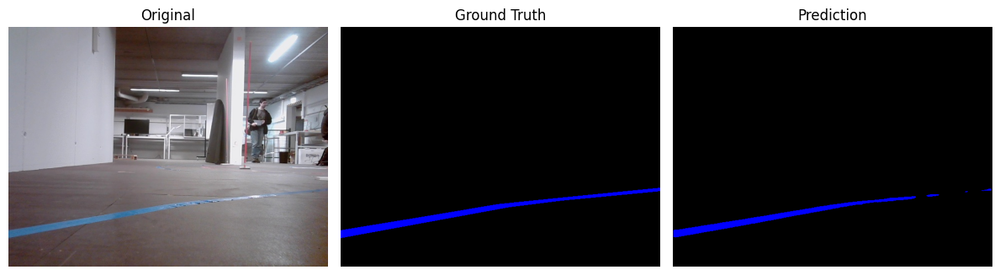


Image 31: frame_0389.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 98.71%


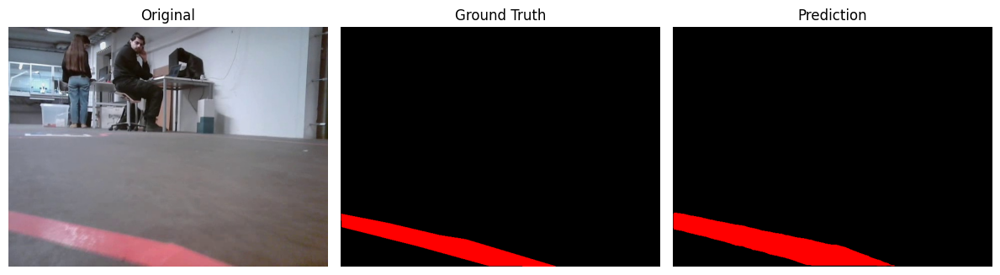


Image 32: frame_0099.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.45%


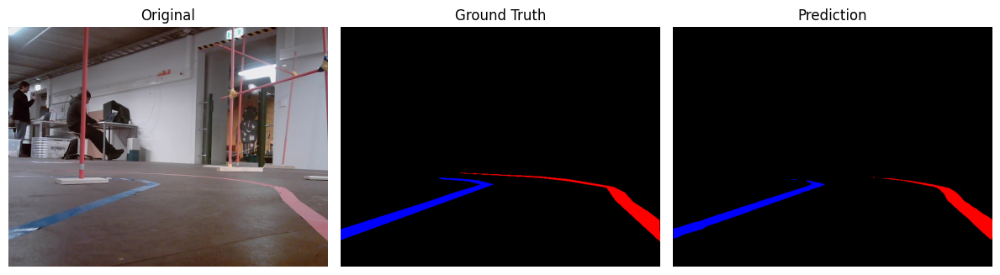


Image 33: frame_0367.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.61%


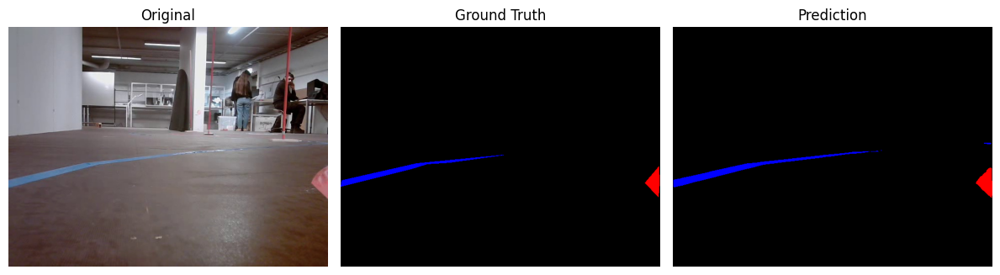


Image 34: frame_0352.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.32%


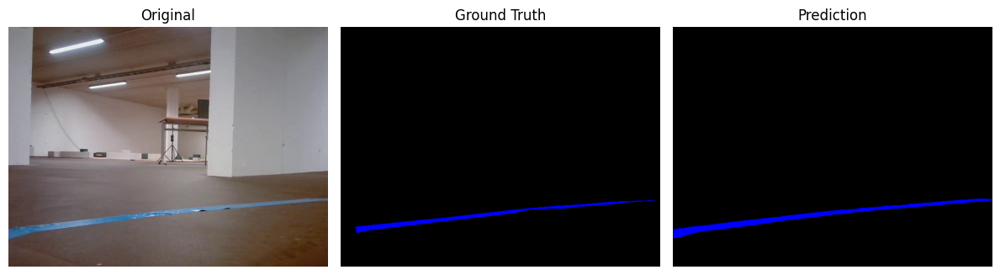


Image 35: frame_0270.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.25%


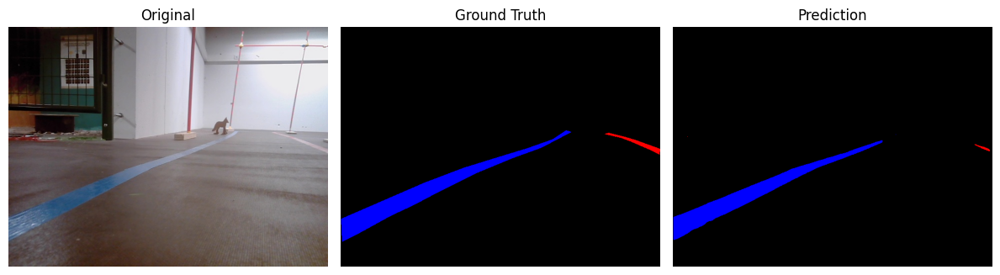


Image 36: frame_0044.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.74%


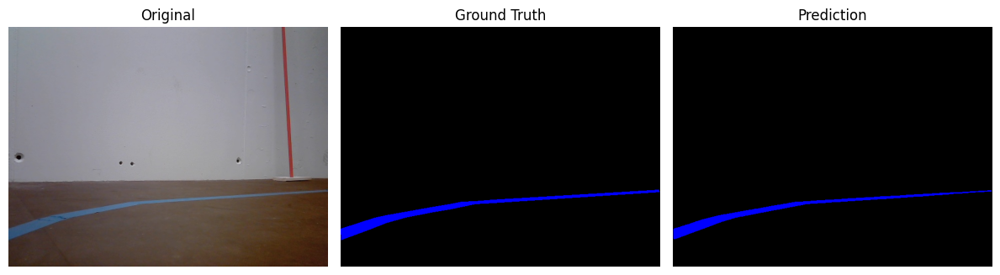


Image 37: frame_0470.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.61%


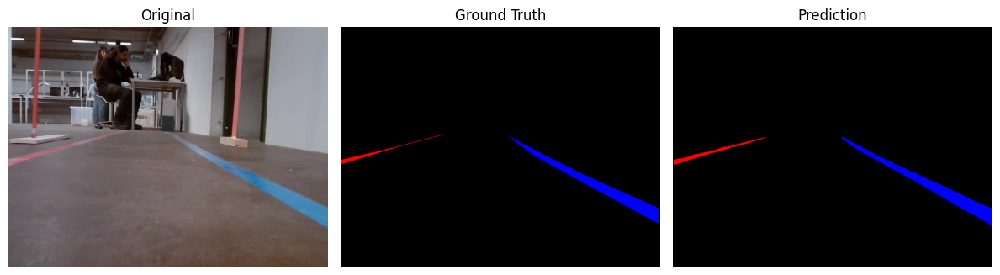


Image 38: frame_0549.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.09%


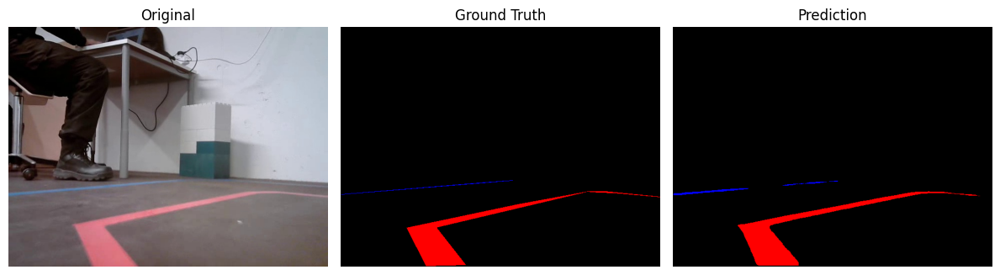


Image 39: frame_0127.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 99.29%


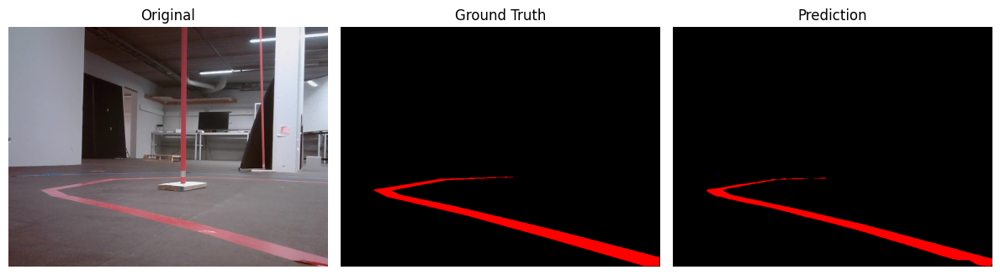


Image 40: frame_0387.jpg
✔️ 🟥 Red Lane only
🎯 Pixel Accuracy: 98.89%


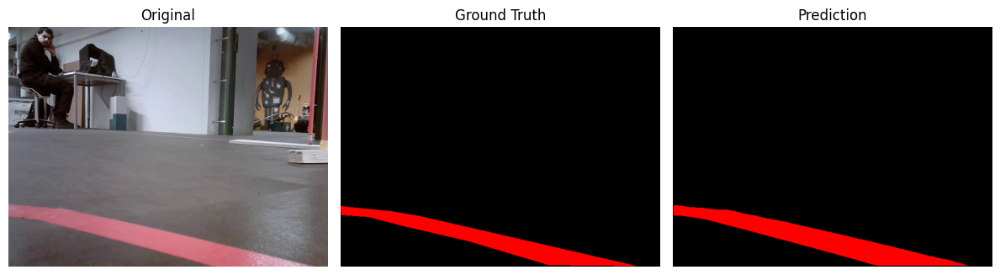


Image 41: frame_0080.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.64%


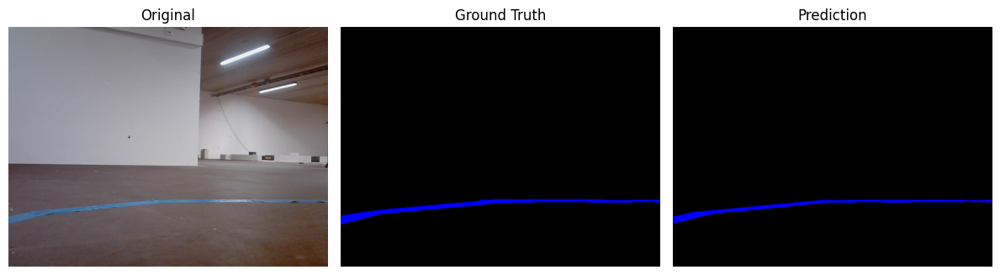


Image 42: frame_0565.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 98.73%


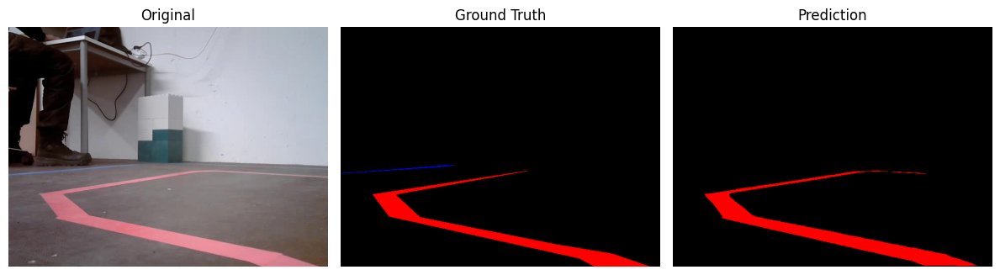


Image 43: frame_0300.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.29%


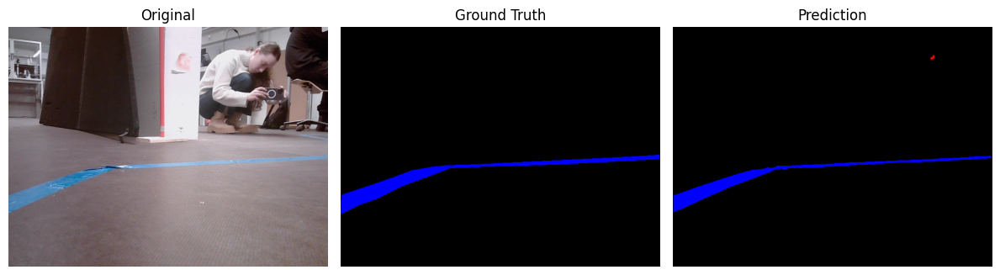


Image 44: frame_0370.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.08%


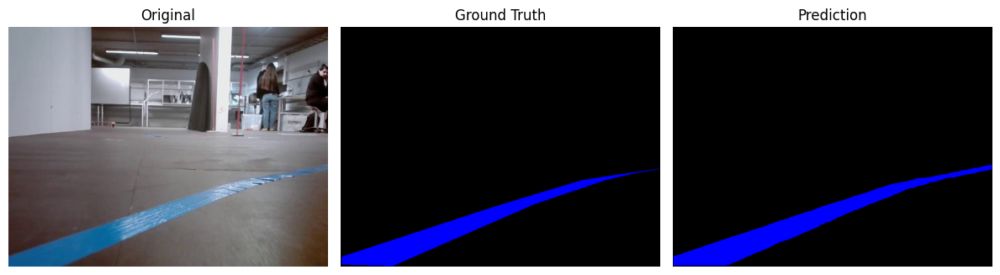


Image 45: frame_0196.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.43%


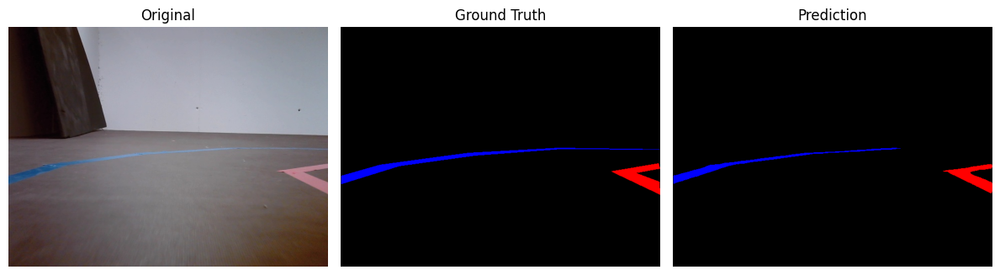


Image 46: frame_0071.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.40%


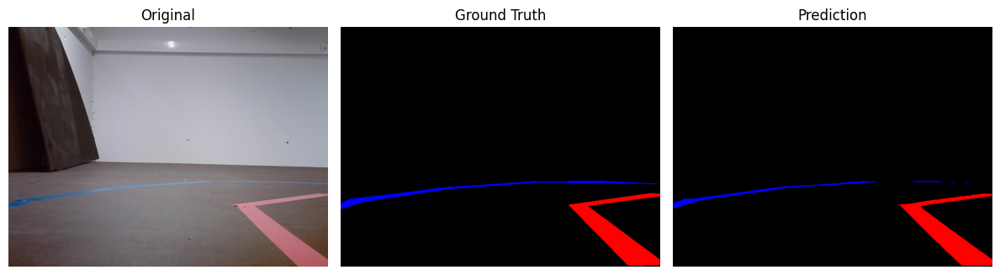


Image 47: frame_0046.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.70%


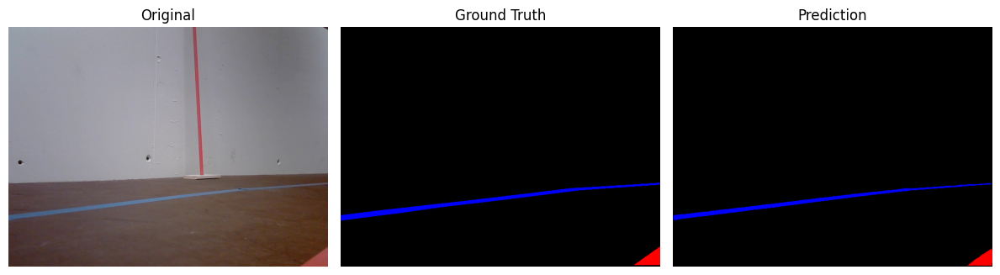


Image 48: frame_0233.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.61%


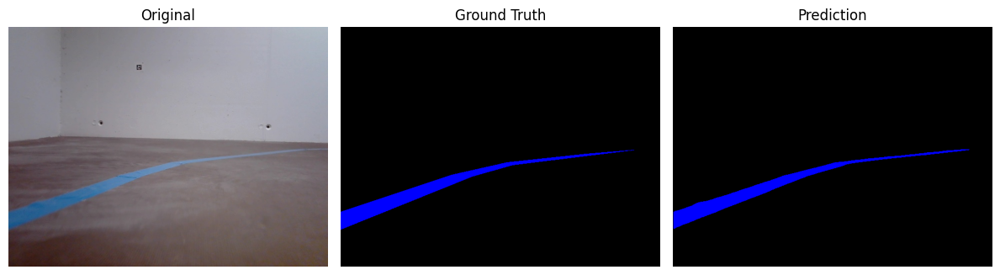


Image 49: frame_0296.jpg
✔️ 🟦 Blue Lane only
🎯 Pixel Accuracy: 99.43%


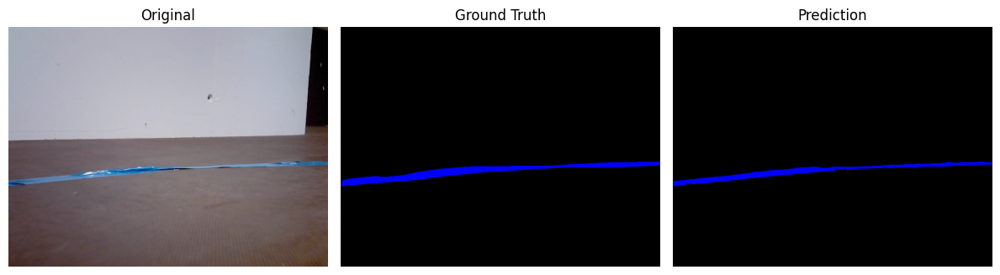


Image 50: frame_0081.jpg
✔️ 🟦 Blue Lane & 🟥 Red Lane
🎯 Pixel Accuracy: 99.56%


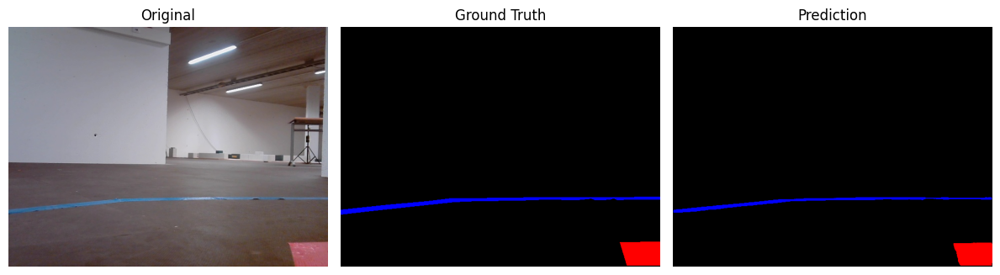


✅ Average Pixel Accuracy over 50 images: 99.39%


In [27]:
import os
import torch
import random
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

# Model is already loaded and on GPU as `model`
model.eval()

# Paths
images_dir = r'C:\Users\stsaa\Desktop\project\dataset\images'
masks_dir = r'C:\Users\stsaa\Desktop\project\dataset\masks'

# Transforms
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])
target_transform = transforms.Compose([
    transforms.Resize((480, 640), interpolation=Image.NEAREST),
])

# Color map: background, blue, red
cmap = ListedColormap([
    (0.0, 0.0, 0.0),  # background (black)
    (1.0, 0.0, 0.0),  # blue lane (blue)
    (0.0, 0.0, 1.0),  # red lane (red)
])

# Remap grayscale values in masks to class indices
def remap_mask(mask):
    mapped = np.zeros_like(mask)
    mapped[mask == 29] = 2  # red lane
    mapped[mask == 76] = 1  # blue lane
    return mapped

# Load images
image_filenames = sorted([f for f in os.listdir(images_dir) if f.endswith('.jpg')])
random.seed(42)
selected_images = random.sample(image_filenames, 50)

accuracies = []

for idx, img_file in enumerate(selected_images):
    img_path = os.path.join(images_dir, img_file)
    mask_path = os.path.join(masks_dir, img_file.replace('.jpg', '_mask.png'))

    image_pil = Image.open(img_path).convert('RGB')
    mask_pil = Image.open(mask_path).convert('L')

    image_tensor = transform(image_pil).unsqueeze(0).cuda()
    mask_np = remap_mask(np.array(target_transform(mask_pil)))

    with torch.no_grad():
        pred = model(image_tensor)[0].argmax(0).cpu().numpy()

    # Accuracy
    correct = (pred == mask_np).sum()
    total = mask_np.size
    accuracy = 100 * correct / total
    accuracies.append(accuracy)

    # Class detection
    gt_classes = set(np.unique(mask_np)) - {0}
    has_blue = 1 in gt_classes
    has_red = 2 in gt_classes

    if has_blue and has_red:
        presence = "🟦 Blue Lane & 🟥 Red Lane"
    elif has_blue:
        presence = "🟥 Red Lane only"
    elif has_red:
        presence = "🟦 Blue Lane only"
    else:
        presence = "⚫ No Lanes Detected"

    # Print
    print(f"\nImage {idx+1}: {img_file}")
    print(f"✔️ {presence}")
    print(f"🎯 Pixel Accuracy: {accuracy:.2f}%")

    # Show
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    plt.imshow(image_pil)
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask_np, cmap=cmap, vmin=0, vmax=2)
    plt.title("Ground Truth")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred, cmap=cmap, vmin=0, vmax=2)
    plt.title("Prediction")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Average accuracy
avg_accuracy = sum(accuracies) / len(accuracies)
print(f"\n✅ Average Pixel Accuracy over {len(selected_images)} images: {avg_accuracy:.2f}%")


In [ ]:
import torch
import cv2
import numpy as np
import time
from PIL import Image
import torchvision.transforms as transforms
from matplotlib.colors import ListedColormap
import pathlib

# Define the model architecture as provided
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)


# Initialize the TinyUNet model and load weights
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(r'C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth'))  # Replace with actual path
model.eval()  # Set model to evaluation mode
if torch.cuda.is_available():
    model = model.cuda()

# Patch PosixPath to WindowsPath
pathlib.PosixPath = pathlib.WindowsPath

# Load custom YOLOv5 model (best.pt) using torch.hub
yolo_model = torch.hub.load('ultralytics/yolov5', 'custom', path=r'C:\Users\stsaa\Desktop\project\dataset\best.pt')

# Webcam initialization
cap = cv2.VideoCapture(0)  # 0 for default webcam (use the appropriate index if you have multiple cameras)

# Check if the webcam is opened
if not cap.isOpened():
    print("Error: Could not open webcam.")
    exit()

# Transforms for TinyUNet
transform = transforms.Compose([
    transforms.Resize((480, 640)),  # Resize to match model input size
    transforms.ToTensor()
])

# Color map: background, blue, red
cmap = ListedColormap([
    (0.0, 0.0, 0.0),  # background (black)
    (0.0, 0.0, 1.0),  # blue lane (blue)
    (1.0, 0.0, 0.0),  # red lane (red)
])

# Process frames from the webcam
fps_start_time = time.time()
frame_count = 0

while True:
    ret, frame = cap.read()  # Capture a frame
    if not ret:
        print("Error: Failed to capture frame.")
        break

    # Resize frame to 640x480 for TinyUNet
    frame_resized = cv2.resize(frame, (640, 480))

    # Convert frame to PIL Image for processing with TinyUNet
    image_pil = Image.fromarray(cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB))

    # Apply transformations for TinyUNet
    image_tensor = transform(image_pil).unsqueeze(0)

    # Move the tensor to GPU if necessary
    if torch.cuda.is_available():
        image_tensor = image_tensor.cuda()

    # Get predictions from TinyUNet
    with torch.no_grad():
        pred = model(image_tensor)[0].argmax(0).cpu().numpy()

    # Create a prediction mask (reshape for overlay)
    pred_overlay = np.zeros_like(pred, dtype=np.uint8)
    pred_overlay[pred == 1] = 255  # Blue lane
    pred_overlay[pred == 2] = 128  # Red lane

    # Convert overlay to BGR for color display
    pred_overlay_bgr = cv2.cvtColor(pred_overlay, cv2.COLOR_GRAY2BGR)

    # Overlay prediction on original frame
    frame_with_overlay = cv2.addWeighted(frame_resized, 1, pred_overlay_bgr, 0.6, 0)

    # Run YOLOv5 for object detection (on the same frame)
    results = yolo_model(frame_resized)  # Perform inference with YOLOv5
    detections = results.xyxy[0].cpu().numpy()  # Get the bounding boxes and labels

    # Draw bounding boxes and labels from YOLOv5
    for det in detections:
        x1, y1, x2, y2, conf, cls = det
        label = f"{yolo_model.names[int(cls)]} {conf:.2f}"
        cv2.rectangle(frame_with_overlay, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
        cv2.putText(frame_with_overlay, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Calculate FPS
    frame_count += 1
    elapsed_time = time.time() - fps_start_time
    fps = frame_count / elapsed_time

    # Display the frame with overlay and FPS count
    cv2.putText(frame_with_overlay, f"FPS: {fps:.2f}", (100, 300), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Show the frame with overlay
    cv2.imshow('Webcam Inference with YOLOv5 and TinyUNet', frame_with_overlay)

    # Exit loop on pressing 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the webcam and close windows
cap.release()
cv2.destroyAllWindows()


Using cache found in C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-4-17 Python-3.10.11 torch-2.8.0.dev20250416+cu128 CUDA:0 (NVIDIA GeForce RTX 5070 Ti, 16303MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast)

In [1]:
import cv2
import torch
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
from matplotlib.colors import ListedColormap
import torch.nn as nn

# ========= Define the model =========
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ========= Load the model =========
model_path = r'C:\Users\stsaa\Desktop\project\tinyunet_model.pth'
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(model_path, map_location='cuda' if torch.cuda.is_available() else 'cpu'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

# ========= Transforms =========
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])
display_transform = transforms.Resize((480, 640), interpolation=Image.NEAREST)

# ========= Color map for visualization =========
cmap = ListedColormap([
    (0.0, 0.0, 0.0),  # background
    (1.0, 0.0, 0.0),  # blue lane (label 1)
    (0.0, 0.0, 1.0),  # red lane (label 2)
])

# ========= Remap function (if using grayscale label images) =========
def remap_mask(mask):
    mapped = np.zeros_like(mask)
    mapped[mask == 29] = 2  # red lane
    mapped[mask == 76] = 1  # blue lane
    return mapped

# ========= Inference function =========
def infer_frame(frame):
    pil_image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    resized = transform(pil_image).unsqueeze(0)
    if torch.cuda.is_available():
        resized = resized.cuda()

    with torch.no_grad():
        output = model(resized)[0]  # shape: (C, H, W)
        pred = output.argmax(0).cpu().numpy()
        conf = torch.nn.functional.softmax(output, dim=0).max(0).values.cpu().numpy()

    return pred, conf

# ========= Overlay segmentation on original image =========
def annotate_frame(frame, pred_mask):
    overlay = np.zeros_like(frame, dtype=np.uint8)
    overlay[pred_mask == 1] = [0, 255, 0]  # red lane
    overlay[pred_mask == 2] = [0, 255, 255]  # blue lane
    return cv2.addWeighted(frame, 0.7, overlay, 0.7, 0)

# ========= Run inference on video =========
video_path = r'C:\Users\stsaa\Desktop\project\videos\4.mp4'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_resized = cv2.resize(frame, (640, 480))
    pred_mask, conf_mask = infer_frame(frame_resized)

    # Lane presence text
    unique_classes = set(np.unique(pred_mask)) - {0}
    if 1 in unique_classes and 2 in unique_classes:
        presence = "🟦 Blue Lane & 🟥 Red Lane"
    elif 2 in unique_classes:
        presence = "🟦 Blue Lane only"
    elif 1 in unique_classes:
        presence = "🟥 Red Lane only"
    else:
        presence = "⚫ No Lanes Detected"

    annotated = annotate_frame(frame_resized.copy(), pred_mask)
    cv2.putText(annotated, presence, (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

    cv2.imshow("Lane Detection", annotated)
    if cv2.waitKey(1) & 0xFF == 27:  # ESC key to break
        break

cap.release()
cv2.destroyAllWindows()


In [1]:
import cv2
import torch
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import torch.nn as nn

# ========= Define the model =========
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ========= Load the model =========
model_path = r'C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth'
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(model_path, map_location='cuda' if torch.cuda.is_available() else 'cpu'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

# ========= Transforms =========
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

# ========= Inference function =========
def infer_frame(frame):
    pil_image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    resized = transform(pil_image).unsqueeze(0)
    if torch.cuda.is_available():
        resized = resized.cuda()

    with torch.no_grad():
        output = model(resized)[0]  # shape: (C, H, W)
        pred = output.argmax(0).cpu().numpy()
        conf = torch.nn.functional.softmax(output, dim=0).max(0).values.cpu().numpy()

    return pred, conf

# ========= Annotate + lane center logic =========
def annotate_frame(frame, pred_mask):
    overlay = np.zeros_like(frame, dtype=np.uint8)
    overlay[pred_mask == 1] = [0, 255, 0]      # red lane (green overlay)
    overlay[pred_mask == 2] = [0, 255, 255]    # blue lane (yellow overlay)
    combined = cv2.addWeighted(frame, 0.7, overlay, 0.7, 0)

    h, w = pred_mask.shape
    roi = pred_mask[int(h * 0.7):, :]

    red_y, red_x = np.where(roi == 1)
    blue_y, blue_x = np.where(roi == 2)

    lane_center_x = None
    draw_y = int(h * 0.8)

    if len(red_x) > 0:
        red_center_x = int(np.mean(red_x))
        red_x_abs = red_center_x
        cv2.line(combined, (red_x_abs, int(h * 0.6)), (red_x_abs, h), (0, 255, 0), 2)
    else:
        red_center_x = None

    if len(blue_x) > 0:
        blue_center_x = int(np.mean(blue_x))
        blue_x_abs = blue_center_x
        cv2.line(combined, (blue_x_abs, int(h * 0.6)), (blue_x_abs, h), (0, 255, 255), 2)
    else:
        blue_center_x = None

    if red_center_x is not None and blue_center_x is not None:
        lane_center_x = (red_center_x + blue_center_x) // 2
        # Draw center line between lanes
        cv2.line(combined, (lane_center_x, int(h * 0.6)), (lane_center_x, h), (255, 255, 255), 2)
        # Draw center marker
        cv2.drawMarker(combined, (lane_center_x, draw_y), (255, 255, 255),
                       markerType=cv2.MARKER_TILTED_CROSS, markerSize=20, thickness=2)

    return combined, lane_center_x

# ========= Run inference on video =========
video_path = r'C:\Users\stsaa\Desktop\project\dataset\videos\1.mp4'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_resized = cv2.resize(frame, (640, 480))
    pred_mask, conf_mask = infer_frame(frame_resized)

    unique_classes = set(np.unique(pred_mask)) - {0}
    annotated, lane_center_x = annotate_frame(frame_resized.copy(), pred_mask)

    h, w, _ = frame_resized.shape
    center_x_frame = w // 2

    # Movement direction logic
    if lane_center_x is not None and 0.45 * w < lane_center_x < 0.55 * w:
        presence = "⬆️ Forward"
    elif 2 in unique_classes and 1 not in unique_classes:
        presence = "➡️ Go Right"
    elif 1 in unique_classes and 2 not in unique_classes:
        presence = "⬅️ Go Left"
    elif 1 in unique_classes and 2 in unique_classes:
        presence = "🟦 Blue & 🟥 Red Lanes"
    elif 2 in unique_classes:
        presence = "🟦 Blue Lane only"
    elif 1 in unique_classes:
        presence = "🟥 Red Lane only"
    else:
        presence = "⚫ No Lanes Detected"

    # Draw movement suggestion
    cv2.putText(annotated, presence, (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

    # Show result
    cv2.imshow("Lane Detection", annotated)
    if cv2.waitKey(1) & 0xFF == 27:  # ESC key
        break

cap.release()
cv2.destroyAllWindows()


In [4]:
import cv2
import torch
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import torch.nn as nn

# ========= Define the model =========
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ========= Load the model =========
model_path = r'C:\Users\stsaa\Desktop\project\tinyunet_model.pth'
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(model_path, map_location='cuda' if torch.cuda.is_available() else 'cpu'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

# ========= Transforms =========
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

# ========= Inference function =========
def infer_frame(frame):
    pil_image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    resized = transform(pil_image).unsqueeze(0)
    if torch.cuda.is_available():
        resized = resized.cuda()

    with torch.no_grad():
        output = model(resized)[0]  # shape: (C, H, W)
        pred = output.argmax(0).cpu().numpy()
        conf = torch.nn.functional.softmax(output, dim=0).max(0).values.cpu().numpy()

    return pred, conf

# ========= Red & Blue mask only =========
def mask_only_frame(pred_mask):
    h, w = pred_mask.shape
    mask_vis = np.zeros((h, w, 3), dtype=np.uint8)
    mask_vis[pred_mask == 2] = [255, 0, 0]   # Blue lane → Blue color

    return mask_vis

# ========= Run inference and show mask =========
video_path = r'C:\Users\stsaa\Desktop\project\videos\1.mp4'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("Error: Could not open video.")
    exit()

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_resized = cv2.resize(frame, (640, 480))
    pred_mask, conf_mask = infer_frame(frame_resized)

    # Create mask-only frame
    mask_output = mask_only_frame(pred_mask)

    # Show result
    cv2.imshow("Lane Mask", mask_output)
    if cv2.waitKey(1) & 0xFF == 27:  # ESC key to exit
        break

cap.release()
cv2.destroyAllWindows()


In [ ]:
import torch
import cv2
import socket
import numpy as np
import time
from PIL import Image
import torchvision.transforms as transforms
from matplotlib.colors import ListedColormap
import pathlib
import torch.nn as nn

# ---------------- TinyUNet Model ---------------- #
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)
        self.middle = DoubleConv(64, 128)
        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)
        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ---------------- Model Initialization ---------------- #
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(r'C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

pathlib.PosixPath = pathlib.WindowsPath

yolo_model = torch.hub.load('ultralytics/yolov5', 'custom', path=r'C:\Users\stsaa\Desktop\project\dataset\yolov5n.pt')

# ---------------- UDP Setup ---------------- #
UDP_IP = "0.0.0.0"
UDP_PORT = 5005
MAX_DGRAM = 1400

sock = socket.socket(socket.AF_INET, socket.SOCK_DGRAM)
sock.bind((UDP_IP, UDP_PORT))
sock.settimeout(5)

packets = {}
last_frame_id = -1

# ---------------- Preprocessing ---------------- #
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

cmap = ListedColormap([
    (0.0, 0.0, 0.0),
    (0.0, 0.0, 1.0),
    (1.0, 0.0, 0.0),
])

# ---------------- FPS Counter ---------------- #
fps_start_time = time.time()
frame_count = 0

# ---------------- Main Loop ---------------- #
while True:
    try:
        packet, addr = sock.recvfrom(MAX_DGRAM + 3)
        if len(packet) < 3:
            continue
        frame_id, pkt_id, total_pkts = packet[0], packet[1], packet[2]
        data = packet[3:]

        if frame_id != last_frame_id:
            packets = {}
            last_frame_id = frame_id

        packets[pkt_id] = data

        if len(packets) == total_pkts:
            full_data = b''.join(packets[i] for i in range(total_pkts))
            npdata = np.frombuffer(full_data, dtype=np.uint8)
            frame = cv2.imdecode(npdata, cv2.IMREAD_COLOR)

            if frame is not None:
                frame_resized = cv2.resize(frame, (640, 480))
                image_pil = Image.fromarray(cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB))
                image_tensor = transform(image_pil).unsqueeze(0)
                if torch.cuda.is_available():
                    image_tensor = image_tensor.cuda()

                with torch.no_grad():
                    pred = model(image_tensor)[0].argmax(0).cpu().numpy()

                pred_overlay = np.zeros_like(pred, dtype=np.uint8)
                pred_overlay[pred == 1] = 255
                pred_overlay[pred == 2] = 128
                pred_overlay_bgr = cv2.cvtColor(pred_overlay, cv2.COLOR_GRAY2BGR)
                frame_with_overlay = cv2.addWeighted(frame_resized, 1, pred_overlay_bgr, 0.6, 0)

                results = yolo_model(frame_resized)
                detections = results.xyxy[0].cpu().numpy()

                for det in detections:
                    x1, y1, x2, y2, conf, cls = det
                    label = f"{yolo_model.names[int(cls)]} {conf:.2f}"
                    cv2.rectangle(frame_with_overlay, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
                    cv2.putText(frame_with_overlay, label, (int(x1), int(y1) - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

                # FPS
                frame_count += 1
                elapsed = time.time() - fps_start_time
                fps = frame_count / elapsed
                cv2.putText(frame_with_overlay, f"FPS: {fps:.2f}", (10, 30),
                            cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

                cv2.imshow("UDP Video Inference", frame_with_overlay)
                if cv2.waitKey(1) == 27:
                    break
            packets = {}
    except socket.timeout:
        print("Timeout, no data received.")
        continue

sock.close()
cv2.destroyAllWindows()


Using cache found in C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-4-19 Python-3.10.11 torch-2.8.0.dev20250416+cu128 CUDA:0 (NVIDIA GeForce RTX 5070 Ti, 16303MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master\models\common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast)

KeyboardInterrupt: 

: 

In [2]:
import torch
import cv2
import socket
import numpy as np
import time
from PIL import Image
import torchvision.transforms as transforms
import pathlib
import torch.nn as nn

# ---------------- TinyUNet Model ---------------- #
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)
        self.middle = DoubleConv(64, 128)
        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)
        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ---------------- Model Initialization ---------------- #
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(r'C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

pathlib.PosixPath = pathlib.WindowsPath

yolo_model = torch.hub.load('ultralytics/yolov5', 'custom', path=r'C:\Users\stsaa\Desktop\project\dataset\yolov5n.pt')

# ---------------- TCP Setup ---------------- #
TCP_IP = "0.0.0.0"
TCP_PORT = 5000
BUFFER_SIZE = 1024  # Maximum size of incoming data

# Create a TCP socket and bind it
sock = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
sock.bind((TCP_IP, TCP_PORT))
sock.listen(1)  # Only allow one connection at a time

print("Waiting for a connection...")
connection, client_address = sock.accept()
print(f"Connection established with {client_address}")

# ---------------- Preprocessing ---------------- #
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

# ---------------- FPS Counter ---------------- #
fps_start_time = time.time()
frame_count = 0

# ---------------- Main Loop ---------------- #
while True:
    try:
        # Receive data in chunks from TCP connection
        data = b""
        while len(data) < BUFFER_SIZE:
            packet = connection.recv(BUFFER_SIZE)
            if not packet:
                break
            data += packet

        if data:
            npdata = np.frombuffer(data, dtype=np.uint8)
            frame = cv2.imdecode(npdata, cv2.IMREAD_COLOR)

            if frame is not None:
                frame_resized = cv2.resize(frame, (640, 480))
                image_pil = Image.fromarray(cv2.cvtColor(frame_resized, cv2.COLOR_BGR2RGB))
                image_tensor = transform(image_pil).unsqueeze(0)
                if torch.cuda.is_available():
                    image_tensor = image_tensor.cuda()

                with torch.no_grad():
                    pred = model(image_tensor)[0].argmax(0).cpu().numpy()

                # Create color overlay
                pred_overlay_bgr = np.zeros_like(frame_resized)

                # Green for class 1 (blue tape)
                pred_overlay_bgr[pred == 1] = [0, 255, 0]  # BGR: Green

                # Yellow for class 2 (red tape)
                pred_overlay_bgr[pred == 2] = [0, 255, 255]  # BGR: Yellow

                # Blend overlay with original frame
                frame_with_overlay = cv2.addWeighted(frame_resized, 1, pred_overlay_bgr, 0.6, 0)

                # YOLO object detection
                results = yolo_model(frame_resized)
                detections = results.xyxy[0].cpu().numpy()

                for det in detections:
                    x1, y1, x2, y2, conf, cls = det
                    label = f"{yolo_model.names[int(cls)]} {conf:.2f}"
                    cv2.rectangle(frame_with_overlay, (int(x1), int(y1)), (int(x2), int(y2)), (255, 0, 0), 2)
                    cv2.putText(frame_with_overlay, label, (int(x1), int(y1) - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

                # FPS display
                frame_count += 1
                elapsed = time.time() - fps_start_time
                fps = frame_count / elapsed
                cv2.putText(frame_with_overlay, f"FPS: {fps:.2f}", (10, 30),
                            cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

                cv2.imshow("TCP Video Inference", frame_with_overlay)
                if cv2.waitKey(1) == 27:
                    break
    except Exception as e:
        print(f"Error: {e}")
        break

# Close the connection and the socket
connection.close()
sock.close()
cv2.destroyAllWindows()


Using cache found in C:\Users\stsaa/.cache\torch\hub\ultralytics_yolov5_master
YOLOv5  2025-4-19 Python-3.10.11 torch-2.8.0.dev20250416+cu128 CUDA:0 (NVIDIA GeForce RTX 5070 Ti, 16303MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


Waiting for a connection...
Connection established with ('172.20.10.14', 39778)


KeyboardInterrupt: 

In [5]:
import cv2
import torch
import numpy as np
from PIL import Image
import torchvision.transforms as transforms
import torch.nn as nn

# ========= Define the model =========
class DoubleConv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.conv(x)

class TinyUNet(nn.Module):
    def __init__(self, in_ch=3, out_ch=3):
        super().__init__()
        self.down1 = DoubleConv(in_ch, 32)
        self.pool1 = nn.MaxPool2d(2)
        self.down2 = DoubleConv(32, 64)
        self.pool2 = nn.MaxPool2d(2)

        self.middle = DoubleConv(64, 128)

        self.up2 = nn.ConvTranspose2d(128, 64, 2, stride=2)
        self.upconv2 = DoubleConv(128, 64)
        self.up1 = nn.ConvTranspose2d(64, 32, 2, stride=2)
        self.upconv1 = DoubleConv(64, 32)

        self.out = nn.Conv2d(32, out_ch, 1)

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(self.pool1(d1))
        m = self.middle(self.pool2(d2))
        u2 = self.upconv2(torch.cat([self.up2(m), d2], dim=1))
        u1 = self.upconv1(torch.cat([self.up1(u2), d1], dim=1))
        return self.out(u1)

# ========= Load the model =========
model_path = r'C:\Users\stsaa\Desktop\project\dataset\tinyunet_model.pth'
model = TinyUNet(in_ch=3, out_ch=3)
model.load_state_dict(torch.load(model_path, map_location='cuda' if torch.cuda.is_available() else 'cpu'))
model.eval()
if torch.cuda.is_available():
    model = model.cuda()

# ========= Transforms =========
transform = transforms.Compose([
    transforms.Resize((480, 640)),
    transforms.ToTensor()
])

# ========= Inference function =========
def infer_frame(frame):
    pil_image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    resized = transform(pil_image).unsqueeze(0)
    if torch.cuda.is_available():
        resized = resized.cuda()

    with torch.no_grad():
        output = model(resized)[0]  # shape: (C, H, W)
        pred = output.argmax(0).cpu().numpy()
        conf = torch.nn.functional.softmax(output, dim=0).max(0).values.cpu().numpy()

    return pred, conf

# ========= Annotate + lane center logic =========
def annotate_frame(frame, pred_mask):
    overlay = np.zeros_like(frame, dtype=np.uint8)
    overlay[pred_mask == 1] = [0, 255, 0]      # red lane (green overlay)
    overlay[pred_mask == 2] = [0, 255, 255]    # blue lane (yellow overlay)
    combined = cv2.addWeighted(frame, 0.7, overlay, 0.7, 0)

    h, w = pred_mask.shape
    roi = pred_mask[int(h * 0.7):, :]

    red_y, red_x = np.where(roi == 1)
    blue_y, blue_x = np.where(roi == 2)

    lane_center_x = None
    draw_y = int(h * 0.8)

    if len(red_x) > 0:
        red_center_x = int(np.mean(red_x))
        red_x_abs = red_center_x
        cv2.line(combined, (red_x_abs, int(h * 0.6)), (red_x_abs, h), (0, 255, 0), 2)
    else:
        red_center_x = None

    if len(blue_x) > 0:
        blue_center_x = int(np.mean(blue_x))
        blue_x_abs = blue_center_x
        cv2.line(combined, (blue_x_abs, int(h * 0.6)), (blue_x_abs, h), (0, 255, 255), 2)
    else:
        blue_center_x = None

    if red_center_x is not None and blue_center_x is not None:
        lane_center_x = (red_center_x + blue_center_x) // 2
        # Draw center line between lanes
        cv2.line(combined, (lane_center_x, int(h * 0.6)), (lane_center_x, h), (255, 255, 255), 2)
        # Draw center marker
        cv2.drawMarker(combined, (lane_center_x, draw_y), (255, 255, 255),
                       markerType=cv2.MARKER_TILTED_CROSS, markerSize=20, thickness=2)

    return combined, lane_center_x

# ========= Run inference on an image =========
image_path = r'C:\Users\stsaa\Desktop\project\frame_0010.jpg'  # Change to your image path
image = cv2.imread(image_path)

if image is None:
    print("Error: Could not open image.")
    exit()

image_resized = cv2.resize(image, (640, 480))
pred_mask, conf_mask = infer_frame(image_resized)

unique_classes = set(np.unique(pred_mask)) - {0}
annotated, lane_center_x = annotate_frame(image_resized.copy(), pred_mask)

h, w, _ = image_resized.shape
center_x_frame = w // 2

# Movement direction logic
if lane_center_x is not None and 0.45 * w < lane_center_x < 0.55 * w:
    presence = "⬆️ Forward"
elif 2 in unique_classes and 1 not in unique_classes:
    presence = "➡️ Go Right"
elif 1 in unique_classes and 2 not in unique_classes:
    presence = "⬅️ Go Left"
elif 1 in unique_classes and 2 in unique_classes:
    presence = "🟦 Blue & 🟥 Red Lanes"
elif 2 in unique_classes:
    presence = "🟦 Blue Lane only"
elif 1 in unique_classes:
    presence = "🟥 Red Lane only"
else:
    presence = "⚫ No Lanes Detected"

# Draw movement suggestion
cv2.putText(annotated, presence, (10, 30),
            cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 255, 255), 2)

# Show result
cv2.imshow("Lane Detection", annotated)
cv2.waitKey(0)  # Wait for a key press to close the window
cv2.destroyAllWindows()
